In [1]:
# !pip install catboost plotly

[Данные](https://yadi.sk/d/CBoVCVIxJ2q2cw)

# Обработка лидарных данных
## Сегментация

### Про лидар

![](https://realnoevremya.com/uploads/gallery/b9/7e/35d10da899958110.jpg)

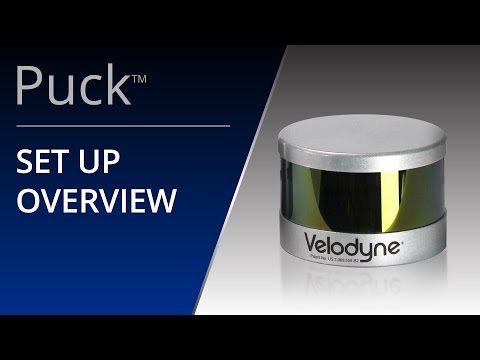

In [2]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('Pa-q5elS_nE')

## А что за данные на самом деле


In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import tqdm
py.init_notebook_mode(connected=True)

EQUAL_ASPECT_RATIO_LAYOUT = dict(
    margin={
        'l': 0,
        'r': 0,
        'b': 0,
        't': 0
    }, scene=dict(
    aspectmode='data'
))


def color(x, cmap='Reds'):
    cmap = plt.get_cmap(cmap)
    x = (x - np.min(x)) / np.max(x)
    
    return cmap(x)

%matplotlib inline

In [2]:
ds = pd.read_csv('snow/snow.csv')
ds = ds.set_index(['scene_id'])
ds.head()

,x,y,z,intensity,ring,label
scene_id,,,,,,
0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0


* intensity - ???
* ring - ???

### Кольцо

![](https://eckop.com/wp-content/uploads/2018/07/LIDAR_02-1024x366.png)

In [5]:
scene = ds.loc[0]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.ring, 'tab20'),
    },
    'text': scene.ring
})

py.iplot(fig)


### Интенсивность

![](https://res.mdpi.com/sensors/sensors-15-28099/article_deploy/html/images/sensors-15-28099-g001-1024.png)

In [6]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)

# Отфильтруем снег

## Эвристикой

In [7]:
def filter_by_intensity(intensity, limit=3):
    # TODO
    return intensity > limit

filtered_scene = scene[filter_by_intensity(scene.intensity)]


fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': filtered_scene.x,
    'y': filtered_scene.y,
    'z': filtered_scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(filtered_scene.intensity, 'seismic'),
    },
    'text': filtered_scene.intensity
})

py.iplot(fig)

Часть шума остается. При этом есть опасность, что мы вырежем что-то важное.

In [3]:
import tensorflow as tf
from sklearn.neighbors import KDTree

/usr/lib/python2.7/dist-packages/h5py/__init__.py:36: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [131]:
class DatasetGenerator(object):
    def __init__(self, dataset, neighbor_size=64, training=True):
        self.neighbor_size = neighbor_size
        self.training = True
        self.by_scene = {}
        
        self.scene_ids = np.unique(dataset.index)
        for scene_id in self.scene_ids:
            slice_dataset = dataset[dataset.index == scene_id]
            xyz = np.stack([slice_dataset.x, slice_dataset.y, slice_dataset.z], axis=-1)
            self.by_scene[scene_id] = {
                'xyz': xyz,
                'intensity': slice_dataset.intensity.values,
                'index': KDTree(xyz),
                'label': slice_dataset.label.values,
            }
            
    def __call__(self):
        if self.training:
            while True:
                output = []
                scene_idx = np.random.choice(self.scene_ids)
                point_id = np.random.choice(len(self.by_scene[scene_idx]['xyz']))
                point_xyz = self.by_scene[scene_idx]['xyz'][point_id]

                neigh_ids, dist = self.by_scene[scene_idx]['index'].query_radius(
                    point_xyz[np.newaxis, :], r=1, return_distance=True)
                neigh_ids = neigh_ids[0][np.argsort(dist[0])]

                xyz_n = self.by_scene[scene_idx]['xyz'][neigh_ids][:self.neighbor_size]
                intensity_n = self.by_scene[scene_idx]['intensity'][neigh_ids][:self.neighbor_size]
                yield (
                        tf.concat([xyz_n - point_xyz, intensity_n[:, None]], axis=-1),
                        self.by_scene[scene_idx]['label'][point_id]
                    )
        else:
            for scene_idx in self.scene_ids:
                for point_id in range(len(self.by_scene[scene_idx]['xyz'])):
                    point_xyz = self.by_scene[scene_idx]['xyz'][point_id]

                    neigh_ids, dist = self.by_scene[scene_idx]['index'].query_radius(
                        point_xyz[np.newaxis, :], r=1, return_distance=True)
                    neigh_ids = neigh_ids[0][np.argsort(dist[0])]

                    xyz_n = self.by_scene[scene_idx]['xyz'][neigh_ids][:self.neighbor_size]
                    intensity_n = self.by_scene[scene_idx]['intensity'][neigh_ids][:self.neighbor_size]
                    yield (
                        tf.concat([xyz_n - point_xyz, intensity_n[:, None]], axis=-1),
                        self.by_scene[scene_idx]['label'][point_id]
                    )
                    
        

In [146]:
len(indices)

291

In [148]:
indices = np.sort(np.unique(ds.index))

In [151]:
len(indices)

291

In [152]:
np.random.seed(100)
np.random.shuffle(indices)

In [155]:
train_ds = ds[ds.index.isin(indices[:200])]
dataset_gen = DatasetGenerator(train_ds)
generator = tf.data.Dataset.from_generator(dataset_gen,
                                           output_types=(tf.float32, tf.float32),
                                           output_shapes=(tf.TensorShape(dims=[None, 4]), tf.TensorShape(dims=[]))
                                    )
generator = generator.padded_batch(batch_size=1024, padded_shapes=((64, 4), ()))

In [181]:
for el in generator:
    break 

In [183]:
el

(<tf.Tensor: shape=(1024, 64, 4), dtype=float32, numpy=
 array([[[ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  2.5000000e+01],
         [-6.9969177e-02,  3.8362499e-02,  4.0965700e-03,  2.3000000e+01],
         [ 7.7136993e-02, -3.5709381e-02, -4.7880700e-03,  2.8000000e+01],
         ...,
         [-2.6528358e-01,  7.4423981e-01,  9.3413681e-02,  1.6000000e+01],
         [ 5.0611877e-01, -6.0385275e-01, -2.2536394e-01,  1.4000000e+01],
         [ 8.0426598e-01, -1.6888094e-01,  4.8712522e-02,  1.7000000e+01]],
 
        [[ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  3.7000000e+01],
         [-1.8592840e-02,  1.5620710e-02,  1.3812888e-01,  3.2000000e+01],
         [-3.4690861e-02, -6.6505909e-02,  1.3943017e-01,  5.0000000e+00],
         ...,
         [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00],
         [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00],
         [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00]],
 
        [[

In [215]:
class PointNet(tf.keras.layers.Layer):
    def __init__(self, name='point_net'):
        super(PointNet, self).__init__(name=name)
    
    def call(self, inputs):
        max_feature_vector = tf.reduce_max(input_tensor=inputs, axis=-2)
        shape = tf.shape(inputs)
        max_feature_vector = tf.tile(max_feature_vector[:, None], (1, shape[1], 1))
        return tf.concat([inputs, max_feature_vector], axis=-1)
    
class Aggregator(tf.keras.layers.Layer):
    def __init__(self, name='aggregator'):
        super(Aggregator, self).__init__(name=name)
    
    def call(self, inputs):
        max_feature_vector = tf.reduce_max(input_tensor=inputs[:, 1:], axis=-2)
        return tf.concat([inputs[:, 0], max_feature_vector], axis=-1)

In [214]:
ds.shape[0] / 291

24061

In [213]:
len(indices)

291

In [216]:
model = tf.keras.Sequential()

In [217]:
model.add(tf.keras.layers.Dense(units=64, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(PointNet())
model.add(tf.keras.layers.Dense(units=64, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(PointNet())
model.add(tf.keras.layers.Dense(units=64, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(PointNet())
model.add(Aggregator())
model.add(tf.keras.layers.Dense(1, activation='sigmoid'))

In [218]:

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


In [ ]:
model.fit(x=generator)

   1807/Unknown - 895s 496ms/step - loss: 0.0349 - accuracy: 0.9885

In [198]:
test_ds = ds[ds.index.isin(indices[200:])]
dataset_test = DatasetGenerator(test_ds)
generator_test = tf.data.Dataset.from_generator(dataset_test,
                                           output_types=(tf.float32, tf.float32),
                                           output_shapes=(tf.TensorShape(dims=[None, 4]), tf.TensorShape(dims=[]))
                                    )
generator_test = generator_test.padded_batch(batch_size=1024, padded_shapes=((64, 4), ()))

In [200]:
result = []
ground_truth = []

for el in generator_test:
    print 1
    aa = model.predict(el[0])
    result.append(aa)
    ground_truth.append(el[1])

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


KeyboardInterrupt: 

In [204]:
ground_truth_con = np.concatenate(ground_truth)

In [205]:
result_con = np.concatenate(result)

In [208]:
from sklearn.metrics import roc_auc_score

In [209]:
roc_auc_score(ground_truth_con, result_con[:, 0])

0.9953352366628581

In [227]:
tf.concat([tf.ones((3, 10, 4)), tf.ones((3, 1, 4))], axis=2)

InvalidArgumentError: ConcatOp : Dimensions of inputs should match: shape[0] = [3,10,4] vs. shape[1] = [3,1,4] [Op:ConcatV2] name: concat

In [219]:
PointNet()

In [212]:
for c in generator:
    break

In [213]:
c

<tf.Tensor: shape=(1, 64, 3), dtype=float32, numpy=
array([[[-0.8525517 , -0.24121477, -0.06759036],
        [-0.8922653 , -0.27560806, -0.06713546],
        [-0.9327779 , -0.3059559 , -0.06670285],
        [-0.962939  , -0.03609467, -0.1413058 ],
        [-0.91976786, -0.02960587, -0.14158738],
        [-0.9404745 ,  0.08080101, -0.2136395 ],
        [-0.85811496,  0.1138792 , -0.21408214],
        [-0.8970957 ,  0.08343982, -0.21394026],
        [-0.87816477,  0.00108718, -0.14188647],
        [-0.8389008 ,  0.03158283, -0.1421696 ],
        [-0.9212718 ,  0.21405983, -0.28448045],
        [-0.8777156 ,  0.21284962, -0.28484678],
        [-0.8360493 ,  0.2235794 , -0.2850747 ],
        [-0.8167443 ,  0.12864399, -0.2143128 ],
        [-0.8136895 , -0.20271492, -0.06806708],
        [-0.7974682 ,  0.0341978 , -0.14243305],
        [-0.7918165 ,  0.21869373, -0.28548574],
        [-0.77480626,  0.13961315, -0.21456516],
        [-0.7743678 , -0.1759453 , -0.06846977],
        [-0.75305

In [166]:
data = data.batch(2)

In [169]:
for o in data:
    break

In [171]:
o

<tf.Tensor: shape=(1, 1, 1, 128, 3), dtype=float32, numpy=
array([[[[[-0.36025715, -0.8518815 ,  0.0058606 ],
          [-0.391284  , -0.88502216,  0.00795242],
          [-0.35285854, -0.81323147,  0.00699434],
          [ 0.42088604, -0.79944134,  0.15258774],
          [ 0.4261217 , -0.8521552 ,  0.14973798],
          [ 0.44581223, -0.76749706,  0.15126935],
          [-0.46888924, -0.7200599 ,  0.02644059],
          [-0.45092678, -0.68632364,  0.02596077],
          [-0.4845991 , -0.6319041 ,  0.033019  ],
          [-0.45513153, -0.6007333 ,  0.03092939],
          [-0.3962202 , -0.5809083 ,  0.02453464],
          [-0.41536617, -0.48774529,  0.0316658 ],
          [-0.38801098, -0.37472892,  0.03294733],
          [-0.44209003, -0.39493084,  0.03880039],
          [-0.34070396, -0.3496852 ,  0.02817559],
          [-0.3299265 , -0.5635996 ,  0.01706523],
          [ 0.47691345, -0.55015135,  0.15627623],
          [ 0.2771349 ,  0.25168943, -0.02508676],
          [ 0.13447475,

In [126]:
iterator = iter(data)

In [127]:
iterator.get_next()

OutOfRangeError: End of sequence

In [118]:
data = data.batch(64)

In [130]:
for a in data:
    break

In [133]:
a

NameError: name 'a' is not defined

## Облачные вычисления

In [8]:
from sklearn.neighbors import KDTree

class ComputeFeatures(object):
    def __init__(self, r=1.0):
        self.xyz = None
        self.intensity = None
        self.ring = None
        self.index = None
        self.r = r

    def _feature_names(self):
        # TODO: return list of feature names
        return [x.format(self.r) for x in [
            "min_intensity_{}", "max_intensity_{}", "median_intensity_{}", "std_intensity_{}",
            "min_ring_{}", "max_ring_{}", "median_ring_{}", "std_ring_{}",
            "r_std_{}",
            "n_neighbours_{}"]] + ["intensity", "ring"]

        
    def compute_point_features(self, point_id, neighbours):
        # TODO: return list of features for given neighbours
        # neighbours is list of indices
        if len(neighbours) > 0:
            xyz_n, intensity_n, ring_n = self.xyz[neighbours], self.intensity[neighbours], self.ring[neighbours]

            rel_xyz = xyz_n - self.xyz[point_id][np.newaxis, :]
            rel_r = np.linalg.norm(rel_xyz, axis=1) / np.linalg.norm(self.xyz[point_id])
        
            return [
                np.min(intensity_n), np.max(intensity_n), np.median(intensity_n), np.std(intensity_n), 
                np.min(ring_n), np.max(ring_n), np.median(ring_n), np.std(ring_n),
                np.std(rel_r),
                len(neighbours),
                self.intensity[point_id], self.ring[point_id]
            ]
        else:
            return [
                0, 0, 0, 0,
                0, 0, 0, 0,
                0,
                len(neighbours),
                self.intensity[point_id], self.ring[point_id]
            ]
                
    
    def get_point_neighbours(self, point_id):
        return self.index.query_radius(self.xyz[point_id][np.newaxis, :], r=self.r)[0]
        
    def __call__(self, xyz, intensity, ring):
        self.xyz = xyz[:]
        self.intensity = intensity[:]
        self.ring = ring[:]
        
        self.index = KDTree(self.xyz)
        
        features = []
        for point_id in range(len(self.xyz)):
            neighbours = self.get_point_neighbours(point_id)
            features.append(self.compute_point_features(point_id, neighbours))
        
        
        return pd.DataFrame(columns=self._feature_names(), data=features)
    


In [11]:
import os
os.mkdir('features')

OSError: [Errno 17] File exists: 'features'

In [8]:
features = ComputeFeatures(r=1.0)

for scene_id in tqdm.tqdm(ds.reset_index().scene_id.unique()):
    scene = ds.loc[scene_id]
    features_df = \
        features(scene[['x', 'y', 'z']].values, scene.intensity.values, scene.ring.values)
    features_df.to_csv('./features/{}.csv'.format(scene_id))

100%|██████████| 291/291 [31:01<00:00,  7.64s/it]


In [8]:
ds.loc[scene_id].label.values

NameError: name 'scene_id' is not defined

In [12]:
ds_features = []
for scene in os.listdir('features'):
    scene_features = pd.read_csv(os.path.join('features', scene))
    scene_id = int(scene.split('.')[0])
    scene_features['scene_id'] = scene_id
    scene_features['label'] = ds.loc[scene_id].label.values
    ds_features.append(scene_features)

In [13]:
ds_features = pd.concat(ds_features)

In [14]:
ds_features = ds_features.drop(['Unnamed: 0'], axis=1)

In [15]:
ds_features.head()

,min_intensity_1.0,max_intensity_1.0,median_intensity_1.0,std_intensity_1.0,min_ring_1.0,max_ring_1.0,median_ring_1.0,std_ring_1.0,r_std_1.0,n_neighbours_1.0,intensity,ring,scene_id,label
0,6.0,6.0,6.0,0.0,6.0,6.0,6.0,0.0,0.000000,1,6.0,6.0,101,1.0
1,3.0,5.0,4.0,1.0,7.0,7.0,7.0,0.0,0.001790,2,3.0,7.0,101,1.0
2,3.0,5.0,4.0,1.0,7.0,7.0,7.0,0.0,0.001789,2,5.0,7.0,101,1.0
3,4.0,8.0,6.0,2.0,6.0,6.0,6.0,0.0,0.002488,2,8.0,6.0,101,1.0
4,4.0,8.0,6.0,2.0,6.0,6.0,6.0,0.0,0.002497,2,4.0,6.0,101,1.0


In [16]:
ds_features.shape

(7001791, 14)

# Посмотрим на разметку

In [16]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.label, 'seismic'),
    },
    'text': scene.label
})

py.iplot(fig)

## Поучим что-нибудь

In [26]:
indices = np.arange(0, np.max(ds_features.scene_id) + 1)
np.random.shuffle(indices)


train = ds_features[ds_features.scene_id.isin(indices[:200])] # TODO train test split, but how
test = ds_features[ds_features.scene_id.isin(indices[230:])]
val = ds_features[ds_features.scene_id.isin(indices[200:230])]

In [31]:
train.head()

,min_intensity_1.0,max_intensity_1.0,median_intensity_1.0,std_intensity_1.0,min_ring_1.0,max_ring_1.0,median_ring_1.0,std_ring_1.0,r_std_1.0,n_neighbours_1.0,intensity,ring,scene_id,label
0,2.0,2.0,2.0,0.0,31.0,31.0,31.0,0.000000,0.030840,2,2.0,31.0,226,1.0
1,0.0,0.0,0.0,0.0,29.0,30.0,30.0,0.471405,0.048047,3,0.0,30.0,226,1.0
2,2.0,2.0,2.0,0.0,31.0,31.0,31.0,0.000000,0.029457,2,2.0,31.0,226,1.0
3,0.0,0.0,0.0,0.0,30.0,30.0,30.0,0.000000,0.000000,1,0.0,30.0,226,1.0
4,2.0,2.0,2.0,0.0,13.0,13.0,13.0,0.000000,0.000000,1,2.0,13.0,226,1.0


In [34]:
import catboost

def learn(X_train, X_val, y_train, y_val):
    clf = catboost.CatBoostClassifier(n_estimators=100)
    clf.fit(
        X_train, y_train, early_stopping_rounds=10,
        use_best_model=True, eval_set=(X_val.values, y_val.values), verbose=False)
    return clf

X_train = train.drop(["scene_id", "label"], axis=1)
y_train = train.label


X_val = val.drop(["scene_id", "label"], axis=1)
y_val = val.label

In [35]:
cls = learn(X_train, X_val, y_train, y_val)

In [36]:
X_test = test.drop(['scene_id', 'label'], axis=1)
y_test = test.label

from sklearn.metrics import precision_recall_curve, precision_score, recall_score

def test_one(clf, X_test, y_test):
    y_test_hat = clf.predict_proba(X_test)
    pr, rec, thr = precision_recall_curve(y_test, y_test_hat[:, 1])
    ix = np.linspace(1, len(pr)-1, num=2000).astype(int)
    return pr[ix], rec[ix], thr[ix - 1]


def heuristic_filter_scoring():
    pr = []
    rec = []
    filter_range = range(1, 10)
    for i in filter_range:
        y_test_heuristic_hat = np.ones(len(X_test))
        y_test_heuristic_hat[filter_by_intensity(test.intensity, i)] = 0
        pr.append(precision_score(y_test, y_test_heuristic_hat))
        rec.append(recall_score(y_test, y_test_heuristic_hat))
        
    return pr, rec, filter_range

pr_bl, rec_bl, thr_bl = heuristic_filter_scoring()

def plot_pr_rec(*models):
    traces = []
    for model, clf, X_test, y_test in models:
        pr, rec, thr = test_one(clf, X_test, y_test)
        pr_rec = go.Scattergl(x = rec, y = pr, mode='lines', text=thr, name=model)
        traces.append(pr_rec)

    pr_rec_bl = go.Scatter(x = rec_bl, y = pr_bl, mode='lines+markers', text=thr_bl, name='Intensity BL')

    layout = go.Layout(
        title='Precission-recall',
        xaxis=dict(
            title='Recall'
        ),
        yaxis=dict(
            title='Precission'
        ))
    fig = go.Figure(
        data=traces + [pr_rec_bl],
        layout=layout)
    py.iplot(fig)
    
models = [('Catboost classifier', cls, X_test, y_test)]
plot_pr_rec(*models)

In [55]:
for pair in zip(cls.feature_names_, cls.feature_importances_):
    print pair

('min_intensity_1.0', 3.055664100540815)
('max_intensity_1.0', 4.645812651024937)
('median_intensity_1.0', 5.812585610932582)
('std_intensity_1.0', 0.8488174145851127)
('min_ring_1.0', 5.894909834639891)
('max_ring_1.0', 3.5186887792648553)
('median_ring_1.0', 4.051688285430837)
('std_ring_1.0', 26.413311724810153)
('r_std_1.0', 7.036383586056586)
('n_neighbours_1.0', 27.462923749392875)
('intensity', 9.510533663388921)
('ring', 1.7486805999324067)


In [53]:
cls.feature_importances_

array([ 3.0556641 ,  4.64581265,  5.81258561,  0.84881741,  5.89490983,
        3.51868878,  4.05168829, 26.41331172,  7.03638359, 27.46292375,
        9.51053366,  1.7486806 ])

# Повизуализируем

In [37]:
y_test_hat = cls.predict_proba(test.drop(['scene_id', 'label'], axis=1))

In [50]:
indices[230:]

array([205, 102,  35, 166,  95, 259, 145,  52, 202, 203, 284,  29, 122,
       131,  30, 221, 180, 245, 167, 281, 196,   0,  61, 130, 267, 118,
       103, 274, 151,  38, 158,  87, 215,  72,  85, 101, 172, 165,  90,
       227, 204, 142, 185, 114, 163, 250, 177,  75, 254, 247,  43, 146,
        96,  42,  58, 152, 189, 235, 137, 115, 139])

In [51]:
scene_id = 205
scene = ds.loc[scene_id]
scene_predictions = y_test_hat[test.scene_id == scene_id][:, 1]

In [52]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene_predictions, 'seismic'),
    },
    'text': scene_predictions
})

py.iplot(fig)